In [12]:
import numpy as np
import cv2

import PIL.Image as Image
import os

import matplotlib.pylab as plt

import tensorflow as tf
import tensorflow_hub as hub

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

In [13]:
IMAGE_SHAPE = (224,224)
classifier = tf.keras.Sequential([
    hub.KerasLayer("https://tfhub.dev/google/tf2-preview/mobilenet_v2/classification/4", input_shape = IMAGE_SHAPE+(3,))
])

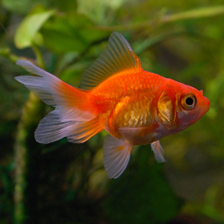

In [14]:
gold_fish = Image.open("goldfish.jpg").resize(IMAGE_SHAPE)
gold_fish

In [15]:
gold_fish = np.array(gold_fish)/255.0
gold_fish.shape

(224, 224, 3)

In [16]:
gold_fish[np.newaxis, ...]

array([[[[0.28235294, 0.33333333, 0.07058824],
         [0.31372549, 0.37254902, 0.09019608],
         [0.34901961, 0.41960784, 0.11764706],
         ...,
         [0.32941176, 0.39215686, 0.00392157],
         [0.32156863, 0.38431373, 0.00392157],
         [0.30980392, 0.36862745, 0.        ]],

        [[0.28627451, 0.33333333, 0.08235294],
         [0.3254902 , 0.38039216, 0.10980392],
         [0.35294118, 0.42352941, 0.12941176],
         ...,
         [0.32156863, 0.38039216, 0.00392157],
         [0.31372549, 0.37254902, 0.00392157],
         [0.30196078, 0.36078431, 0.        ]],

        [[0.28627451, 0.33333333, 0.08627451],
         [0.31372549, 0.36862745, 0.10196078],
         [0.34509804, 0.41568627, 0.12941176],
         ...,
         [0.31764706, 0.37647059, 0.00392157],
         [0.30980392, 0.36862745, 0.00784314],
         [0.29803922, 0.35686275, 0.00392157]],

        ...,

        [[0.05490196, 0.10980392, 0.01568627],
         [0.05098039, 0.11372549, 0.01960784]

In [17]:
result = classifier.predict(gold_fish[np.newaxis, ...])
result.shape

(1, 1001)

In [18]:
predicted_label_index = np.argmax(result)
predicted_label_index

2

In [19]:
# tf.keras.utils.get_file('ImageNetLabels.txt','https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt')
image_labels = []
with open("ImageNetLabels.txt", "r") as f:
    image_labels = f.read().splitlines()
image_labels[:5]

['background', 'tench', 'goldfish', 'great white shark', 'tiger shark']

In [20]:
image_labels[predicted_label_index]

'goldfish'

In [21]:
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    "../data",
    labels="inferred",
    label_mode="int",
    class_names=None,
    color_mode="rgb",
    batch_size=32,
    image_size=(224, 224))

# cache_dir indicates where to download data. I specified . which means current directory
# untar true will unzip it

Found 1828 files belonging to 3 classes.


In [23]:
data_dir = dataset
data_dir

<BatchDataset shapes: ((None, 224, 224, 3), (None,)), types: (tf.float32, tf.int32)>

In [32]:
for (root,dirs,files) in os.walk('datasets/MaizeVillage'):
    print(len(files))

0
353
1270
205


In [62]:
for files in os.walk('datasets/MaizeVillage'):
    print(files)

('datasets/MaizeVillage', ['Maize_Army_Wormy_Damage', 'Maize_Healthy', 'Maize_Other_Damage'], [])
('datasets/MaizeVillage\\Maize_Army_Wormy_Damage', [], ['20211117_140642.jpg', '20211117_140644.jpg', '20211117_140651.jpg', '20211117_140713.jpg', '20211117_140802.jpg', '20211117_140809.jpg', '20211117_140949.jpg', '20211117_141008.jpg', '20211117_141010.jpg', '20211117_141048.jpg', '20211117_141117.jpg', '20211117_141128.jpg', '20211117_141129.jpg', '20211117_141149.jpg', '20211117_141153.jpg', '20211122_183835.jpg', '20211122_183840.jpg', '20211122_183842.jpg', '20211122_184108.jpg', '20211122_184109.jpg', '20211122_184112.jpg', '20211122_184157.jpg', '20211122_184200.jpg', '20211122_184201.jpg', '20211122_184205.jpg', '20211122_184207.jpg', '20211122_184215.jpg', '20211122_184217.jpg', '20211122_184219.jpg', '20211122_184225.jpg', '20211122_184227.jpg', '20211122_184231.jpg', '20211122_184233.jpg', '20211122_184251.jpg', '20211122_184252.jpg', '20211122_184300.jpg', '20211122_184303.j

In [84]:
import pathlib
Damage = []
Healthy = []
Other_damage = []
for filepath in pathlib.Path('datasets/MaizeVillage/Maize_Army_Wormy_Damage').glob('**/*.jpg'):
    Damage.append(filepath)
for filepath in pathlib.Path('datasets/MaizeVillage/Maize_Healthy').glob('**/*.jpg'):
    Healthy.append(filepath)
for filepath in pathlib.Path('datasets/MaizeVillage/Maize_Other_Damage').glob('**/*.jpg'):
    Other_damage.append(filepath)

In [85]:
Damage

[WindowsPath('datasets/MaizeVillage/Maize_Army_Wormy_Damage/20211117_140642.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Army_Wormy_Damage/20211117_140644.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Army_Wormy_Damage/20211117_140651.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Army_Wormy_Damage/20211117_140713.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Army_Wormy_Damage/20211117_140802.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Army_Wormy_Damage/20211117_140809.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Army_Wormy_Damage/20211117_140949.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Army_Wormy_Damage/20211117_141008.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Army_Wormy_Damage/20211117_141010.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Army_Wormy_Damage/20211117_141048.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Army_Wormy_Damage/20211117_141117.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Army_Wormy_Damage/20211117_141128.jpg'),
 Win

In [86]:
Healthy

[WindowsPath('datasets/MaizeVillage/Maize_Healthy/20211117_140251.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Healthy/20211117_140310.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Healthy/20211122_181429(0).jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Healthy/20211122_181429.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Healthy/20211122_181438.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Healthy/20211122_181440.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Healthy/20211122_181449.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Healthy/20211122_181450.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Healthy/20211122_181451.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Healthy/20211122_181454.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Healthy/20211122_181456.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Healthy/20211122_181457.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Healthy/20211122_181459.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Health

In [87]:
Other_damage

[WindowsPath('datasets/MaizeVillage/Maize_Other_Damage/20211122_181802.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Other_Damage/20211122_181803(0).jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Other_Damage/20211122_181803.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Other_Damage/20211122_181805.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Other_Damage/20211122_181808.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Other_Damage/20211122_181810(0).jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Other_Damage/20211122_181810.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Other_Damage/20211122_182037.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Other_Damage/20211122_182038.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Other_Damage/20211122_182041.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Other_Damage/20211122_182137.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Other_Damage/20211122_182139.jpg'),
 WindowsPath('datasets/MaizeVillage/Maize_Other_Damage/202

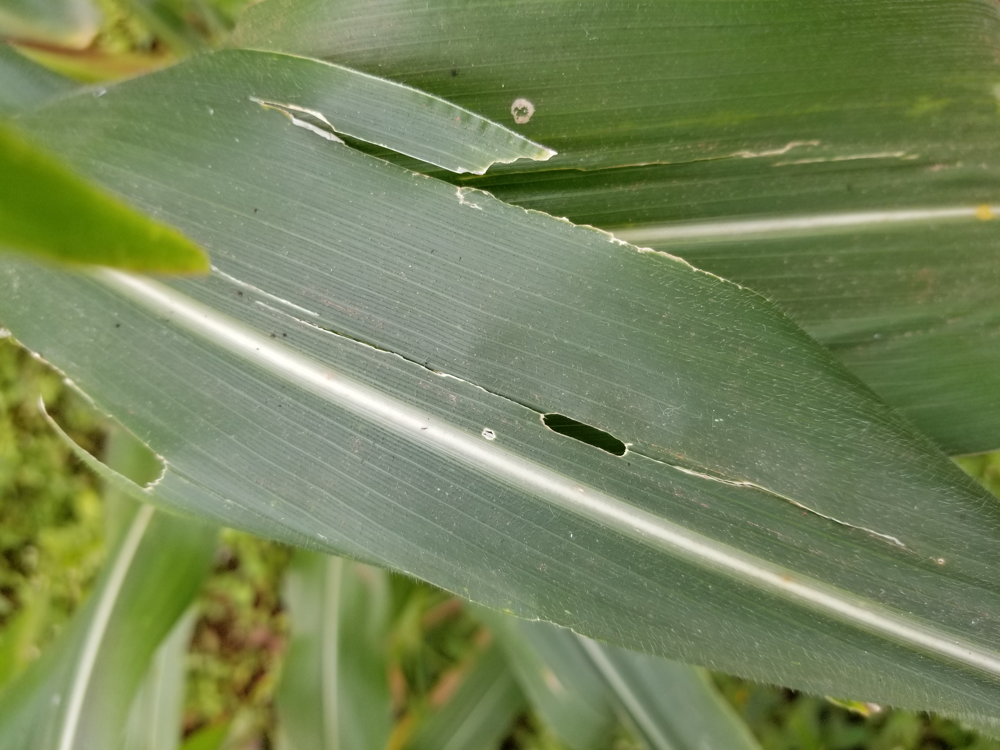

In [88]:
Image.open(str(Damage[0]))

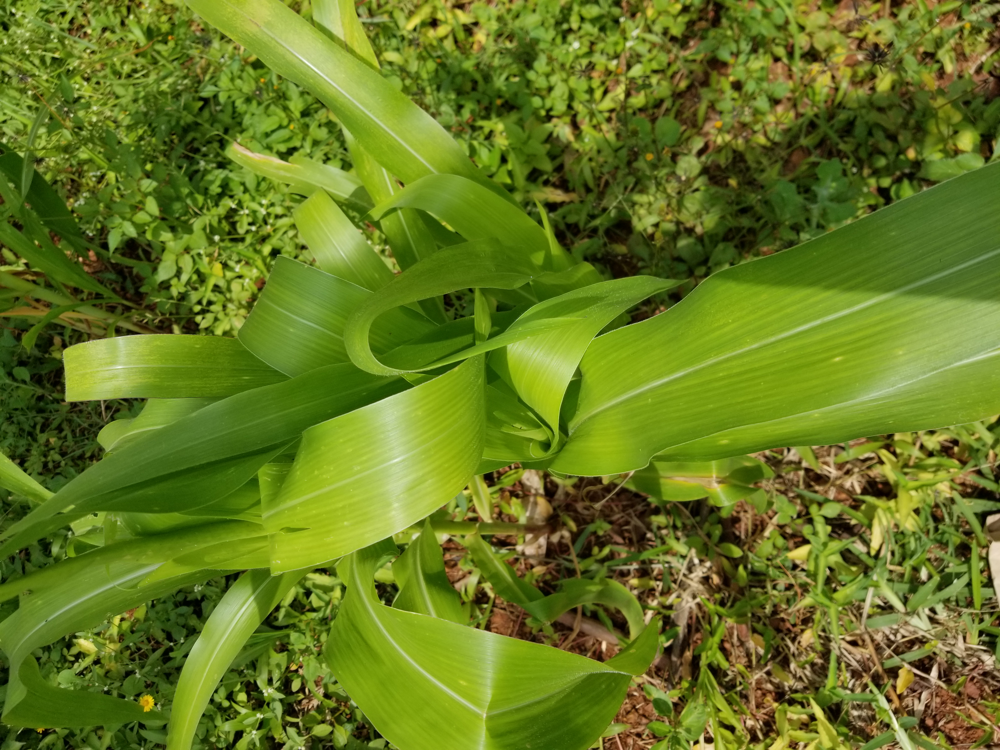

In [90]:
Image.open(str(Healthy[0]))

In [92]:
maize_images_dict = {
    'Army_worm': Damage,
    'Healthy': Healthy,
    'Other_damage': Other_damage,
}

In [93]:
maize_labels_dict = {
    'Army_worm': 0,
    'Healthy': 1,
    'Other_damage': 2,
}

In [95]:
img = cv2.imread(str(maize_images_dict['Army_worm'][0]))

In [96]:
img.shape

(4032, 3024, 3)

In [97]:
cv2.resize(img, IMAGE_SHAPE).shape

(224, 224, 3)

In [102]:
X, y = [], []

for maize_name, images in maize_images_dict.items():
    for image in images:
        img = cv2.imread(str(image))
        resized_img = cv2.resize(img, IMAGE_SHAPE)
        X.append(resized_img)
        y.append(maize_labels_dict[maize_name])

In [103]:
X = np.array(X)
y = np.array(y)

In [104]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

In [105]:
X_train_scaled = X_train / 255
X_test_scaled = X_test / 255

In [106]:
X[0].shape

(224, 224, 3)

In [107]:
IMAGE_SHAPE+(3,)

(224, 224, 3)

In [108]:
x0_resized = cv2.resize(X[0], IMAGE_SHAPE)
x1_resized = cv2.resize(X[1], IMAGE_SHAPE)
x2_resized = cv2.resize(X[2], IMAGE_SHAPE)

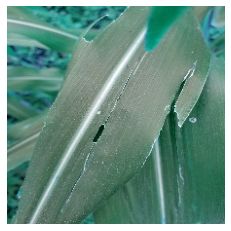

In [109]:
plt.axis('off')
plt.imshow(X[0])

In [110]:
predicted = classifier.predict(np.array([x0_resized, x1_resized, x2_resized]))
predicted = np.argmax(predicted, axis=1)
predicted


array([795, 795, 795], dtype=int64)

In [111]:
image_labels[795]

'shower curtain'

In [112]:
feature_extractor_model = "https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4"

pretrained_model_without_top_layer = hub.KerasLayer(
    feature_extractor_model, input_shape=(224, 224, 3), trainable=False)

In [113]:
num_of_maize = 5

model = tf.keras.Sequential([
  pretrained_model_without_top_layer,
  tf.keras.layers.Dense(num_of_maize)
])

model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_2 (KerasLayer)  (None, 1280)              2257984   
                                                                 
 dense (Dense)               (None, 5)                 6405      
                                                                 
Total params: 2,264,389
Trainable params: 6,405
Non-trainable params: 2,257,984
_________________________________________________________________


In [114]:
model.compile(
  optimizer="adam",
  loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
  metrics=['acc'])

model.fit(X_train_scaled, y_train, epochs=5)

Epoch 1/5
43/43 [==============================] - 55s 872ms/step - loss: 0.4899 - acc: 0.8155
Epoch 2/5
43/43 [==============================] - 35s 803ms/step - loss: 0.1829 - acc: 0.9285
Epoch 3/5
43/43 [==============================] - 36s 825ms/step - loss: 0.1296 - acc: 0.9621
Epoch 4/5
43/43 [==============================] - 35s 807ms/step - loss: 0.1059 - acc: 0.9708
Epoch 5/5
43/43 [==============================] - 35s 810ms/step - loss: 0.0871 - acc: 0.9737


In [115]:
model.evaluate(X_test_scaled,y_test)

15/15 [==============================] - 12s 749ms/step - loss: 0.1611 - acc: 0.9475


[0.16114400327205658, 0.9474835991859436]

In [118]:
model.save(f"models/tranfer-learning.h5")